# **Homework 11 - Generative Adversarial Network**

若有任何問題，歡迎來信至助教信箱 ntu-ml-2020spring-ta@googlegroups.com

# Prepare Data


定義我們的 dataset，由於我們之後要使用 torchvision 這個套件來存圖片，因此我們會在這裡將 cv2 讀進來的圖片（BGR）轉成 torchvision 的格式（RGB）。

定義 preprocess: 將 input 形狀 resize 到 (64, 64)，並且將其 value 由 0\~1 線性轉換到 -1~1。

In [1]:
from torch.utils.data import Dataset, DataLoader
import cv2
import os

class FaceDataset(Dataset):
    def __init__(self, fnames, transform):
        self.transform = transform
        self.fnames = fnames
        self.num_samples = len(self.fnames)
    def __getitem__(self,idx):
        fname = self.fnames[idx]
        img = cv2.imread(fname)
        img = self.BGR2RGB(img) #because "torchvision.utils.save_image" use RGB
        img = self.transform(img)
        return img

    def __len__(self):
        return self.num_samples

    def BGR2RGB(self,img):
        return cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

import glob
import torchvision.transforms as transforms

def get_dataset(root):
    fnames = glob.glob(os.path.join(root, '*'))
    # resize the image to (64, 64)
    # linearly map [0, 1] to [-1, 1]
    transform = transforms.Compose(
        [transforms.ToPILImage(),
         transforms.Resize((64, 64)),
         transforms.ToTensor(),
         transforms.Normalize(mean=[0.5] * 3, std=[0.5] * 3) ] )
    dataset = FaceDataset(fnames, transform)
    return dataset

# Some useful functions
這裡我們提供固定 random seed 的函數，以便 reproduce。

In [2]:
import random
import torch
import numpy as np
#固定隨機種子
def same_seeds(seed):
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)  # if you are using multi-GPU.
    np.random.seed(seed)  # Numpy module.
    random.seed(seed)  # Python random module.
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True


# Model
我們使用 DCGAN 作為 baseline mode。圖示為 DCGAN 架構示意圖。圖中的數字僅供參考。
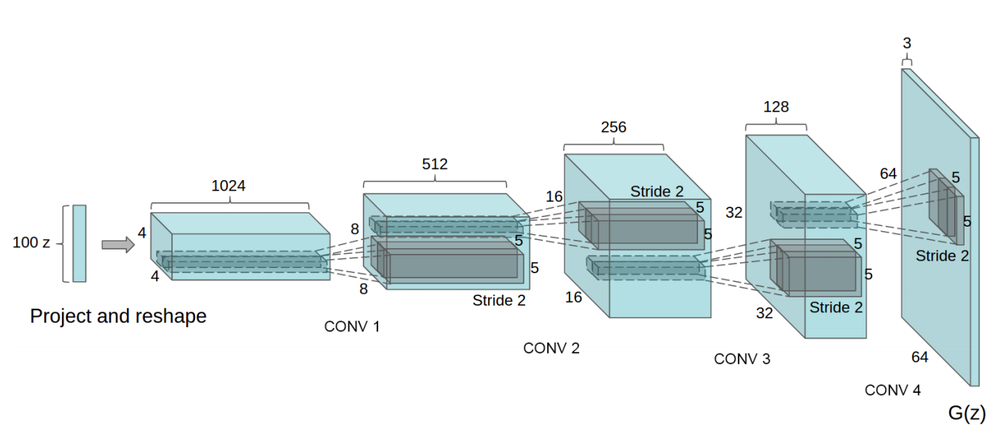

# LSGAN

In [3]:
import torch.nn as nn
import torch.nn.functional as F

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

class Generator(nn.Module):
    """
    input (N, in_dim)
    output (N, 3, 64, 64)
    """
    def __init__(self, in_dim, dim=64):
        super(Generator, self).__init__()
        def dconv_bn_relu(in_dim, out_dim):
            return nn.Sequential(
                nn.ConvTranspose2d(in_dim, out_dim, 5, 2, padding=2, output_padding=1, bias=False),
                nn.BatchNorm2d(out_dim),
                nn.ReLU())
        self.l1 = nn.Sequential(
            nn.Linear(in_dim, dim * 8 * 4 * 4, bias=False),
            nn.BatchNorm1d(dim * 8 * 4 * 4),
            nn.ReLU())
        self.l2_5 = nn.Sequential(
            dconv_bn_relu(dim * 8, dim * 4),
            dconv_bn_relu(dim * 4, dim * 2),
            dconv_bn_relu(dim * 2, dim),
            nn.ConvTranspose2d(dim, 3, 5, 2, padding=2, output_padding=1),
            nn.Tanh())
        self.apply(weights_init)
    def forward(self, x):
        y = self.l1(x)
        y = y.view(y.size(0), -1, 4, 4)
        y = self.l2_5(y)
        return y

class Discriminator(nn.Module):
    """
    input (N, 3, 64, 64)
    output (N, )
    """
    def __init__(self, in_dim, dim=64):
        super(Discriminator, self).__init__()
        def conv_bn_lrelu(in_dim, out_dim):
            return nn.Sequential(
                nn.Conv2d(in_dim, out_dim, 5, 2, 2),
                nn.Dropout(0.3),
                nn.BatchNorm2d(out_dim),
                nn.LeakyReLU(0.2, inplace=True))
        self.ls = nn.Sequential(
            nn.Conv2d(in_dim, dim, 5, 2, 2), 
            nn.Dropout(0.3),
            nn.LeakyReLU(0.2, inplace=True),
            conv_bn_lrelu(dim, dim * 2),
            conv_bn_lrelu(dim * 2, dim * 4),
            conv_bn_lrelu(dim * 4, dim * 8))
        ds_size = dim // 2 ** 4
        self.cls = nn.Linear(dim * 8 * ds_size ** 2, 1)
        self.apply(weights_init)        
    def forward(self, x):
        y = self.ls(x)
        y = y.view(y.shape[0], -1)
        y = self.cls(y)
        return y

# Training

設定好 hyperparameters。
準備好 dataloader, model, loss criterion, optimizer。

In [4]:
import torch
from torch import optim
from torch.autograd import Variable
import torchvision

# hyperparameters 
batch_size = 64
z_dim = 100
lr = 1e-4
n_epoch = 50
save_dir = os.path.join('./', 'logs')
os.makedirs(save_dir, exist_ok=True)

# model
G = Generator(in_dim=z_dim).cuda()
D = Discriminator(3).cuda()
G.train()
D.train()

# loss criterion
#criterion = nn.BCELoss()
criterion = nn.MSELoss()

# optimizer
opt_D = torch.optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))
opt_G = torch.optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))


same_seeds(0)
# dataloader (You might need to edit the dataset path if you use extra dataset.)
dataset = get_dataset('faces')
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=0)

#schd_D = torch.optim.lr_scheduler.OneCycleLR(opt_D, max_lr=0.0001, steps_per_epoch=len(dataloader), epochs=n_epoch)
#schd_G = torch.optim.lr_scheduler.OneCycleLR(opt_G, max_lr=0.0001, steps_per_epoch=len(dataloader), epochs=n_epoch)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


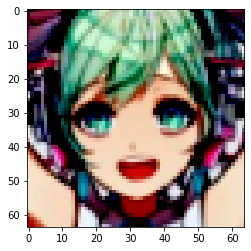

In [5]:
# 隨便印一張圖看看
import matplotlib.pyplot as plt
plt.imshow(dataset[10].numpy().transpose(1,2,0))

接下來就可以開始訓練了。我們定期儲存一些圖片，讓你觀察 Generator 目前的效果。並且定期紀錄 checkpoint。

Epoch [1/50] 1115/1115 Loss_D: 0.2192 Loss_G: 2.0118 | Save some samples to ./logs\Epoch_001.jpg.


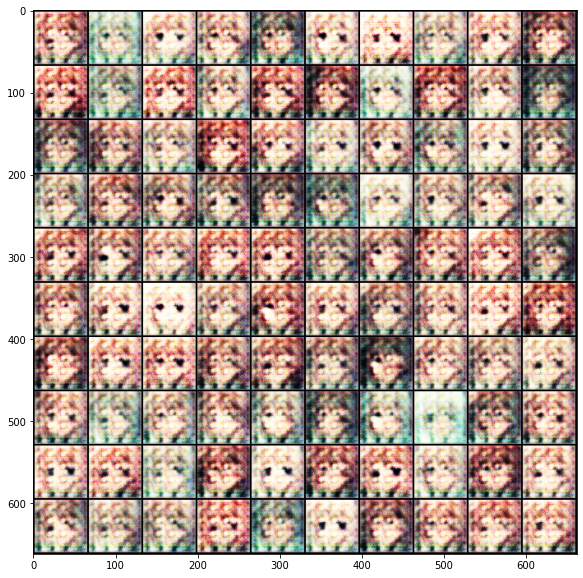

Epoch [2/50] 1115/1115 Loss_D: 0.1454 Loss_G: 0.6391 | Save some samples to ./logs\Epoch_002.jpg.


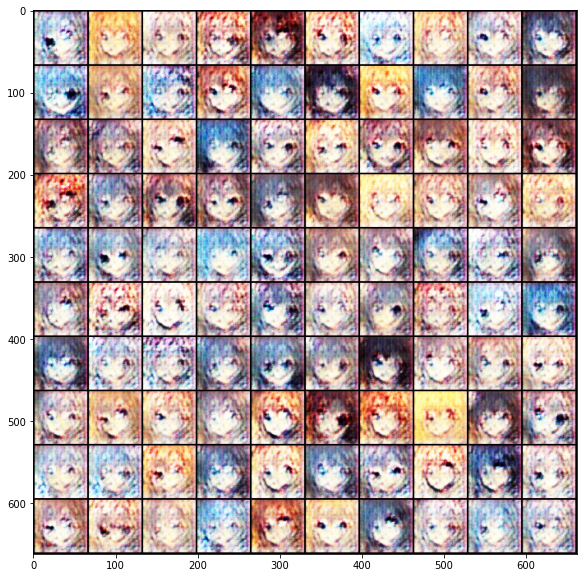

Epoch [3/50] 1115/1115 Loss_D: 0.1032 Loss_G: 0.5299 | Save some samples to ./logs\Epoch_003.jpg.


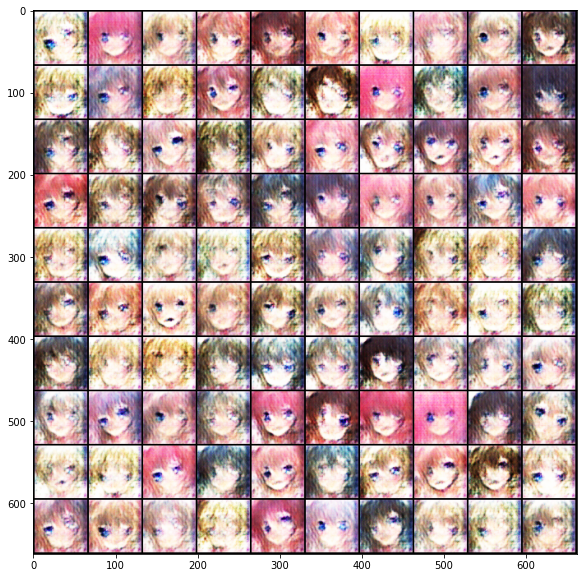

Epoch [4/50] 1115/1115 Loss_D: 0.0998 Loss_G: 0.6259 | Save some samples to ./logs\Epoch_004.jpg.


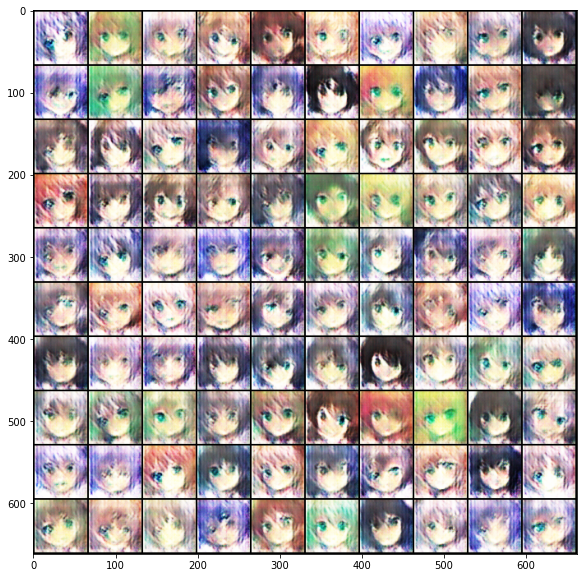

Epoch [5/50] 1115/1115 Loss_D: 0.0909 Loss_G: 1.2728 | Save some samples to ./logs\Epoch_005.jpg.


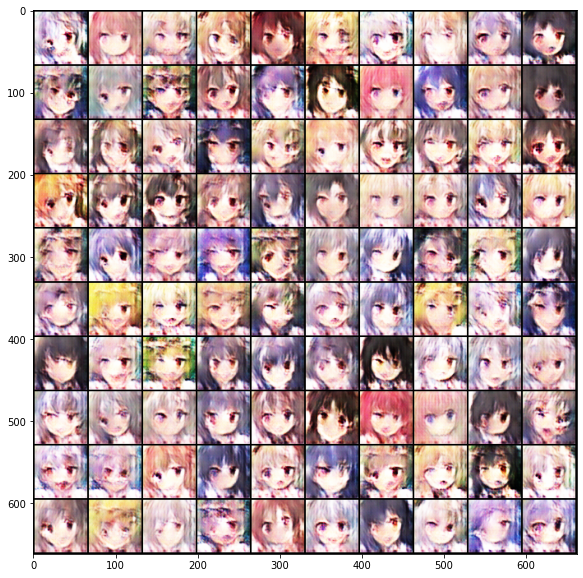

Epoch [6/50] 1115/1115 Loss_D: 0.1940 Loss_G: 0.1526 | Save some samples to ./logs\Epoch_006.jpg.


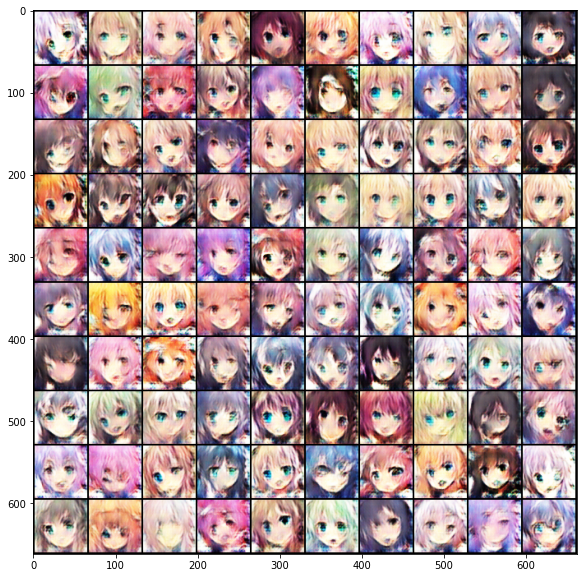

Epoch [7/50] 1115/1115 Loss_D: 0.2038 Loss_G: 0.7350 | Save some samples to ./logs\Epoch_007.jpg.


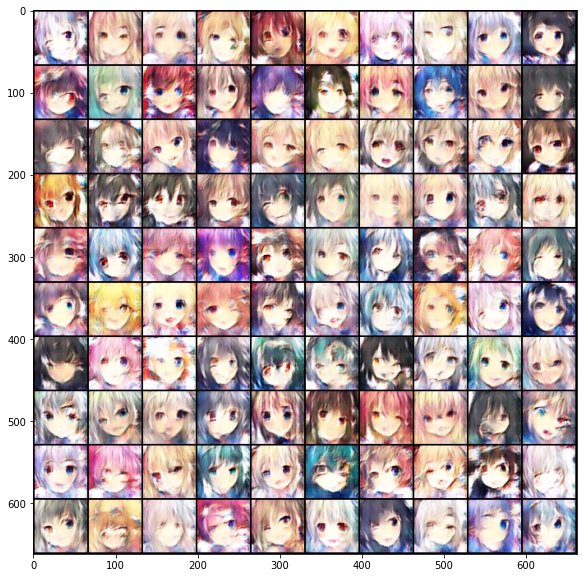

Epoch [8/50] 1115/1115 Loss_D: 0.1180 Loss_G: 0.5924 | Save some samples to ./logs\Epoch_008.jpg.


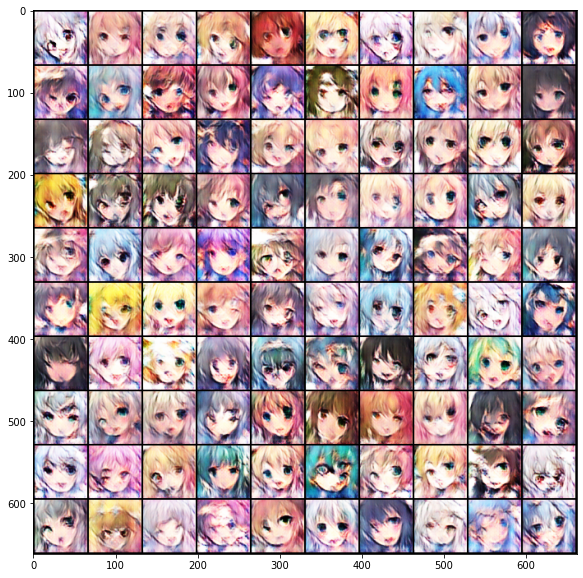

Epoch [9/50] 1115/1115 Loss_D: 0.1062 Loss_G: 1.7189 | Save some samples to ./logs\Epoch_009.jpg.


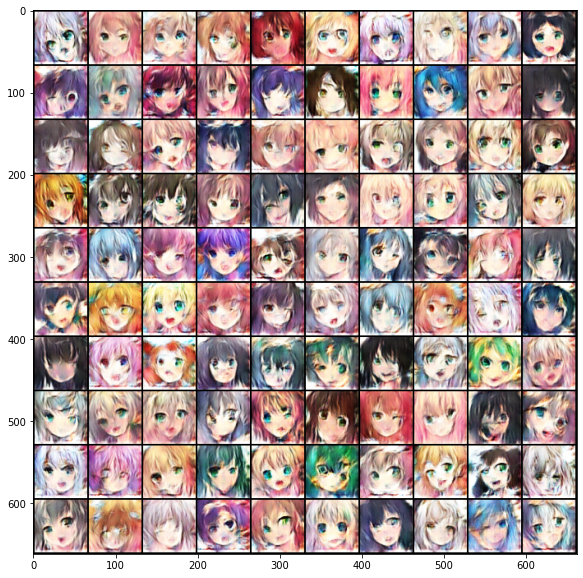

Epoch [10/50] 1115/1115 Loss_D: 0.1502 Loss_G: 1.6056 | Save some samples to ./logs\Epoch_010.jpg.


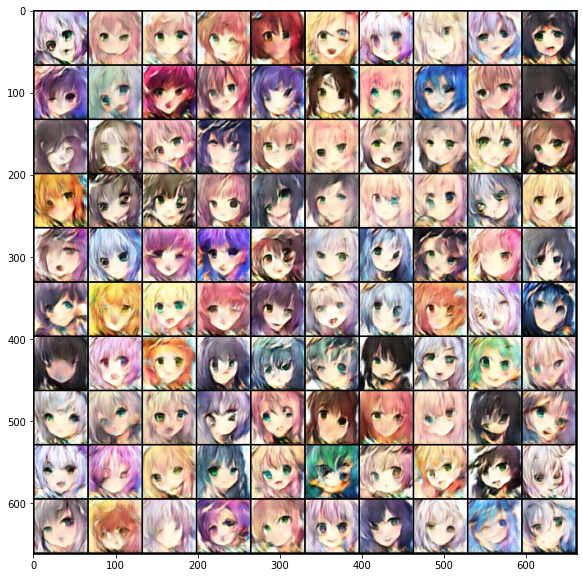

Epoch [11/50] 1115/1115 Loss_D: 0.1858 Loss_G: 0.7984 | Save some samples to ./logs\Epoch_011.jpg.


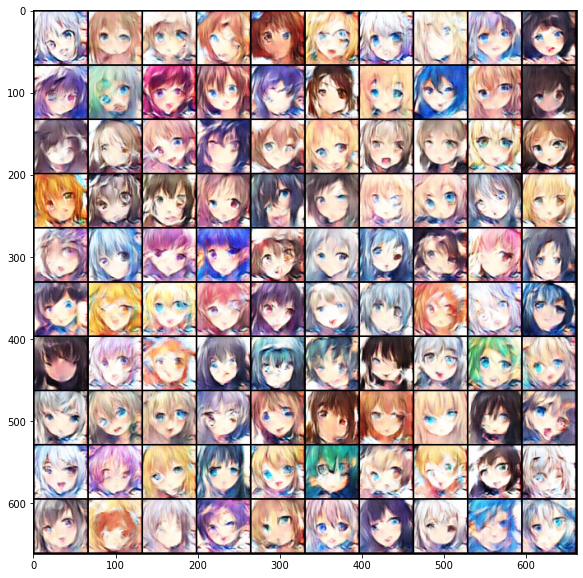

Epoch [12/50] 1115/1115 Loss_D: 0.2524 Loss_G: 1.0973 | Save some samples to ./logs\Epoch_012.jpg.


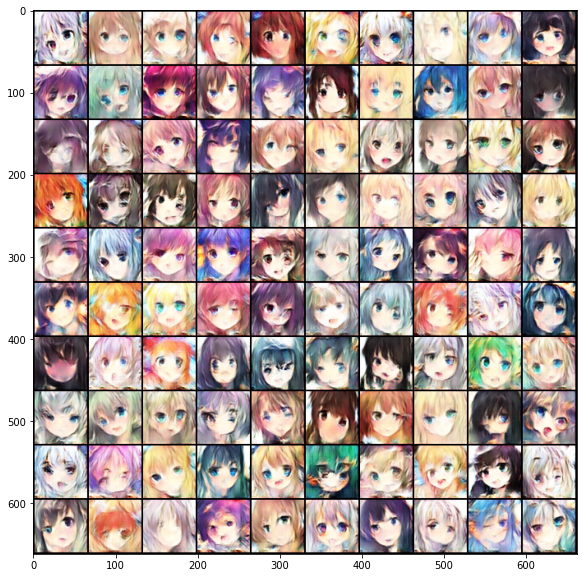

Epoch [13/50] 1115/1115 Loss_D: 0.0991 Loss_G: 0.4196 | Save some samples to ./logs\Epoch_013.jpg.


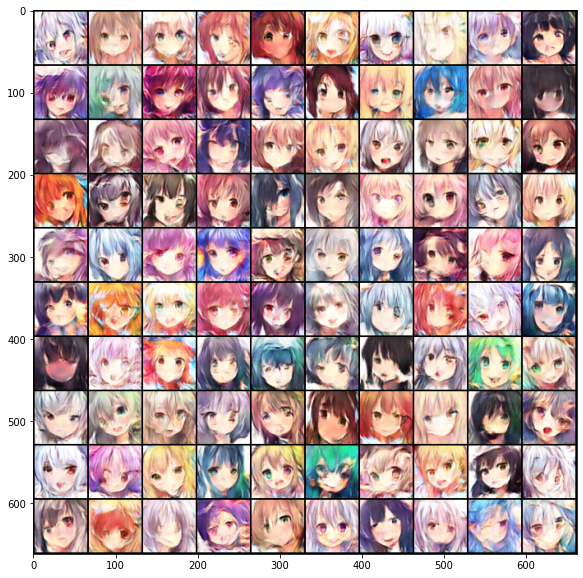

Epoch [14/50] 1115/1115 Loss_D: 0.0876 Loss_G: 0.4293 | Save some samples to ./logs\Epoch_014.jpg.


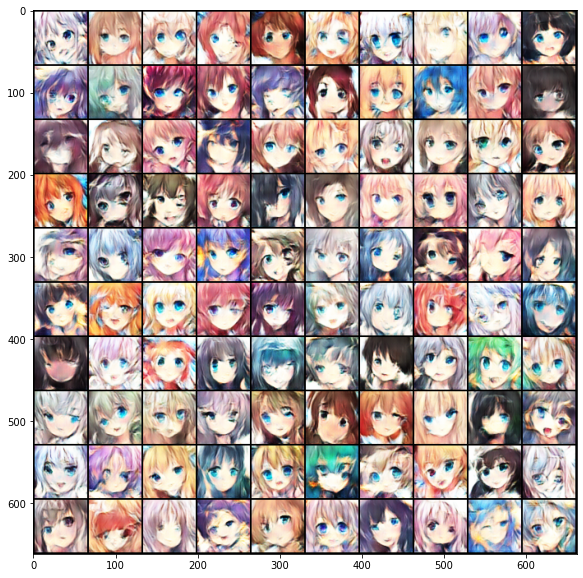

Epoch [15/50] 1115/1115 Loss_D: 0.1284 Loss_G: 0.2897 | Save some samples to ./logs\Epoch_015.jpg.


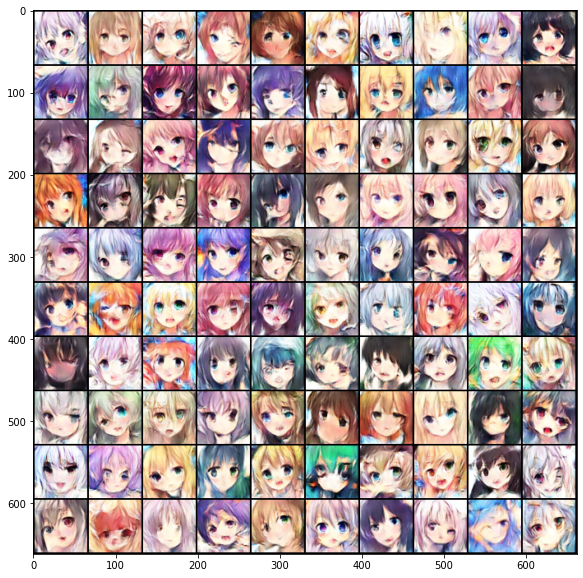

Epoch [16/50] 1115/1115 Loss_D: 0.1310 Loss_G: 1.6371 | Save some samples to ./logs\Epoch_016.jpg.


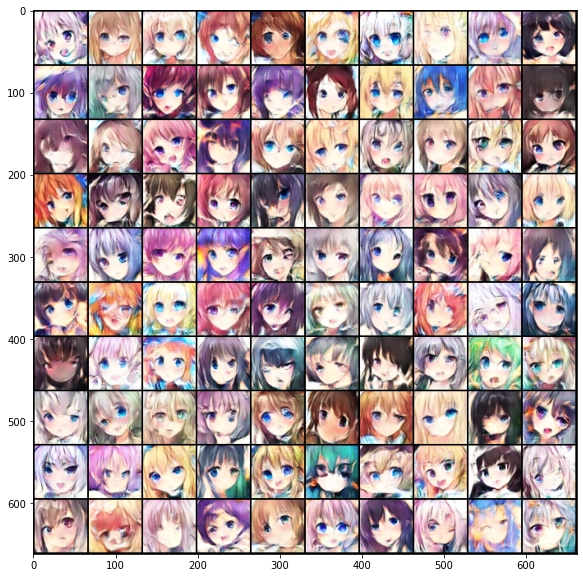

Epoch [17/50] 1115/1115 Loss_D: 0.0879 Loss_G: 0.6827 | Save some samples to ./logs\Epoch_017.jpg.


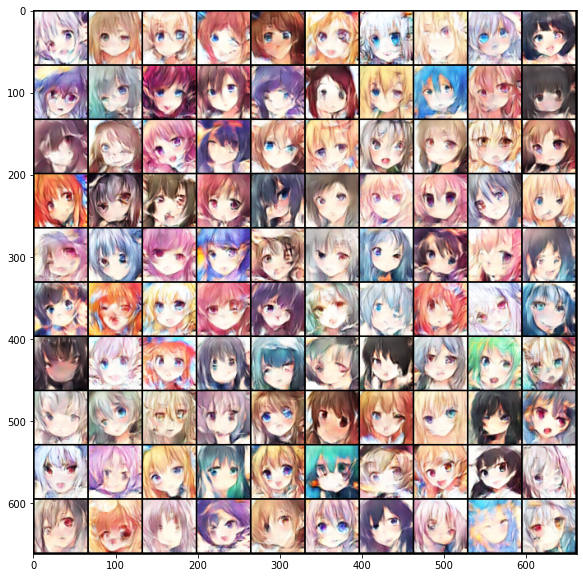

Epoch [18/50] 1115/1115 Loss_D: 0.1199 Loss_G: 0.5146 | Save some samples to ./logs\Epoch_018.jpg.


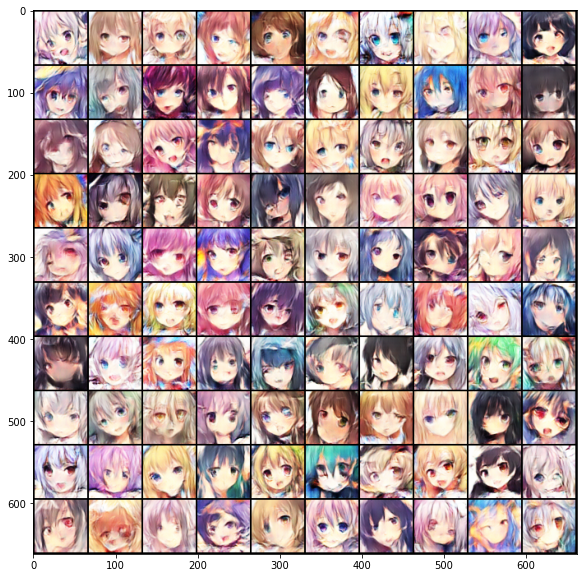

Epoch [19/50] 1115/1115 Loss_D: 0.2104 Loss_G: 0.6056 | Save some samples to ./logs\Epoch_019.jpg.


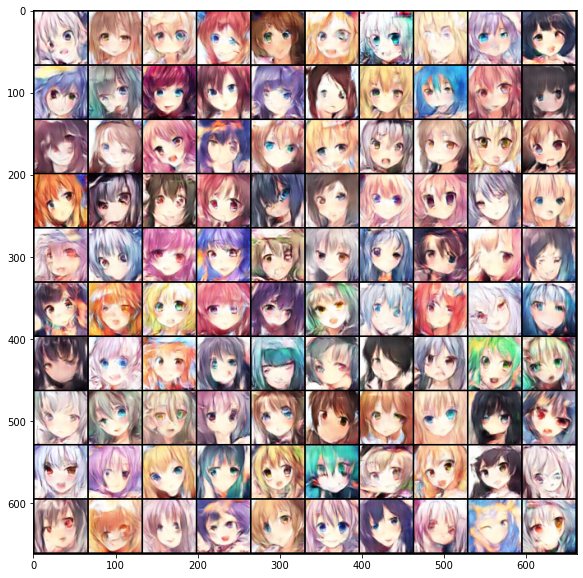

Epoch [20/50] 1115/1115 Loss_D: 0.1263 Loss_G: 1.0985 | Save some samples to ./logs\Epoch_020.jpg.


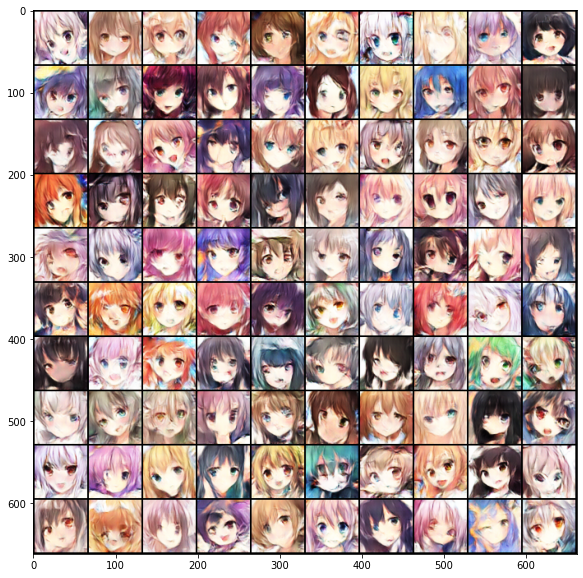

Epoch [21/50] 1115/1115 Loss_D: 0.1244 Loss_G: 1.1870 | Save some samples to ./logs\Epoch_021.jpg.


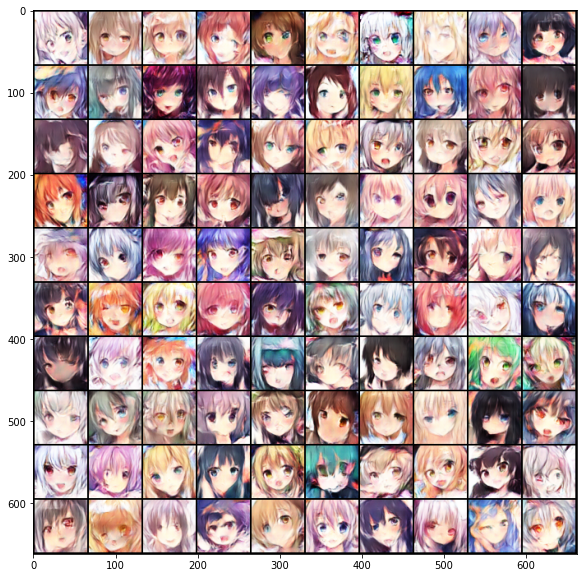

Epoch [22/50] 1115/1115 Loss_D: 0.1936 Loss_G: 0.4882 | Save some samples to ./logs\Epoch_022.jpg.


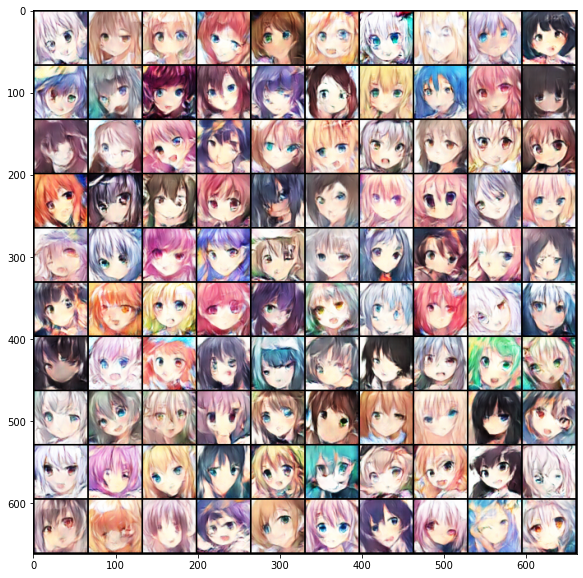

Epoch [23/50] 1115/1115 Loss_D: 0.1227 Loss_G: 0.6610 | Save some samples to ./logs\Epoch_023.jpg.


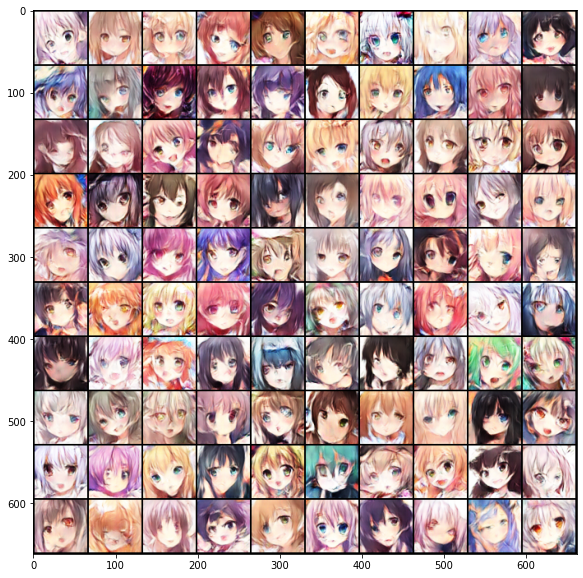

Epoch [24/50] 1115/1115 Loss_D: 0.1240 Loss_G: 0.2513 | Save some samples to ./logs\Epoch_024.jpg.


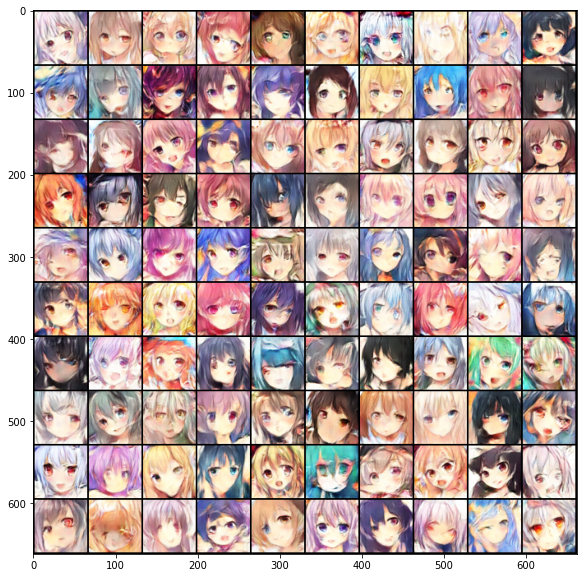

Epoch [25/50] 1115/1115 Loss_D: 0.1829 Loss_G: 0.4317 | Save some samples to ./logs\Epoch_025.jpg.


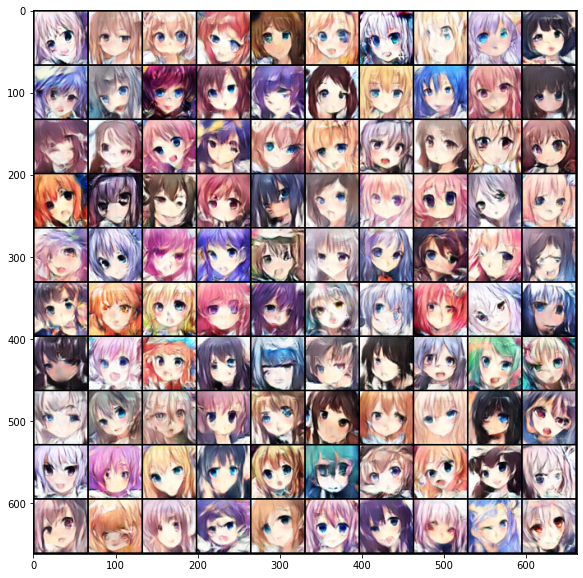

Epoch [26/50] 1115/1115 Loss_D: 0.1837 Loss_G: 0.3639 | Save some samples to ./logs\Epoch_026.jpg.


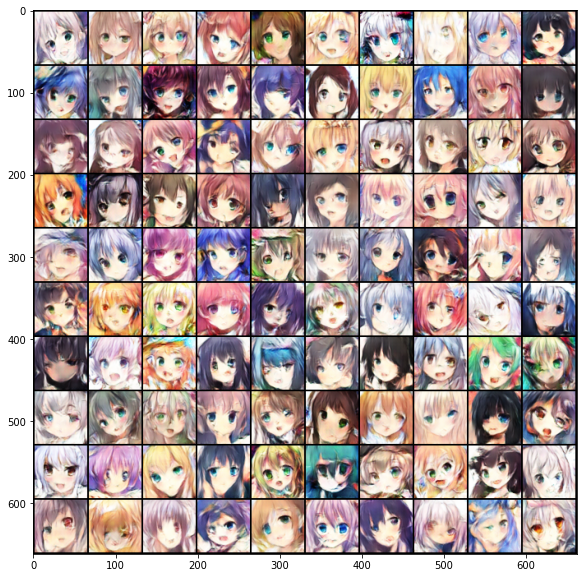

Epoch [27/50] 1115/1115 Loss_D: 0.1305 Loss_G: 1.0155 | Save some samples to ./logs\Epoch_027.jpg.


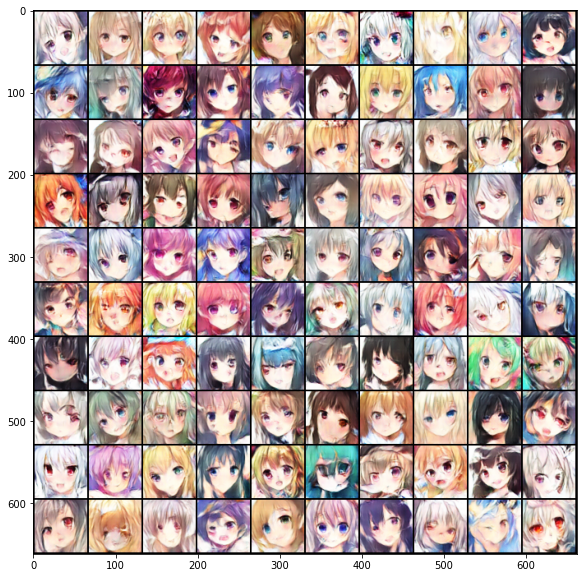

Epoch [28/50] 1115/1115 Loss_D: 0.0754 Loss_G: 0.6050 | Save some samples to ./logs\Epoch_028.jpg.


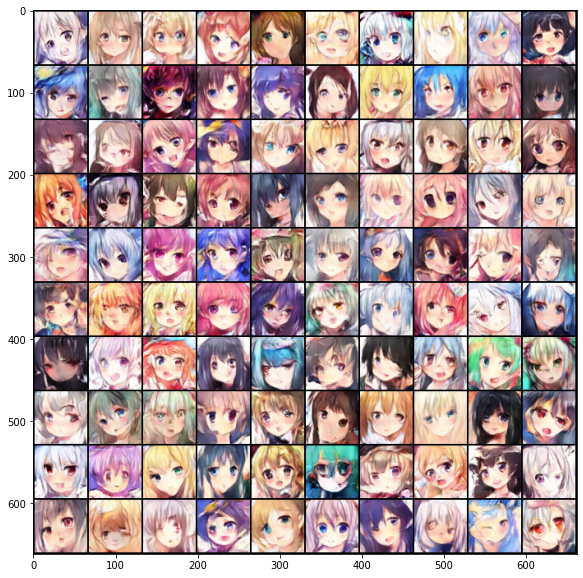

Epoch [29/50] 1115/1115 Loss_D: 0.1520 Loss_G: 1.0389 | Save some samples to ./logs\Epoch_029.jpg.


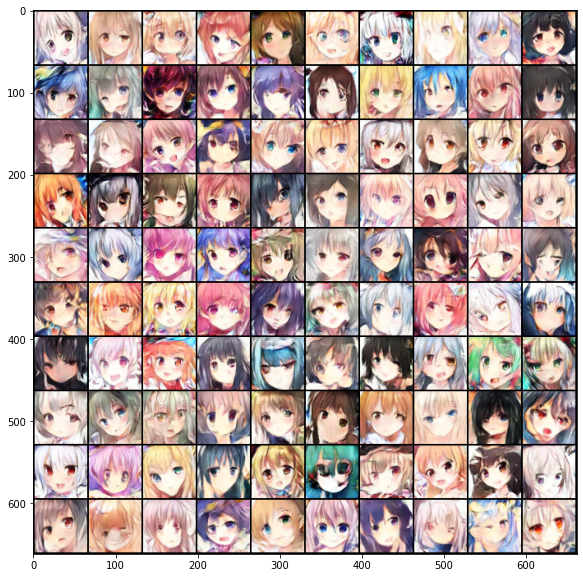

Epoch [30/50] 1115/1115 Loss_D: 0.1159 Loss_G: 0.2567 | Save some samples to ./logs\Epoch_030.jpg.


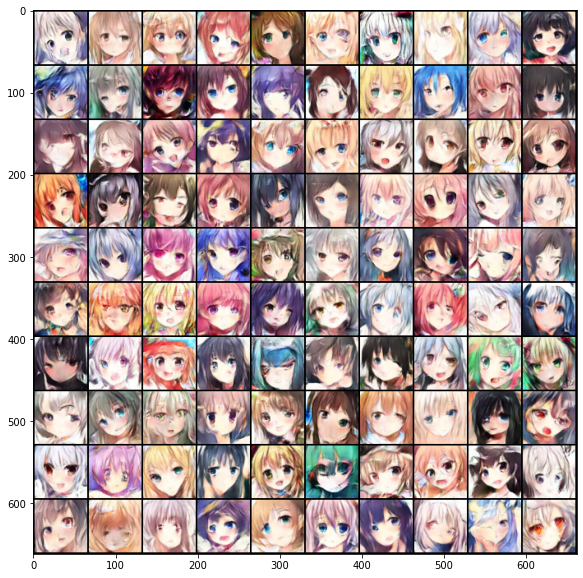

Epoch [31/50] 1115/1115 Loss_D: 0.0759 Loss_G: 0.3443 | Save some samples to ./logs\Epoch_031.jpg.


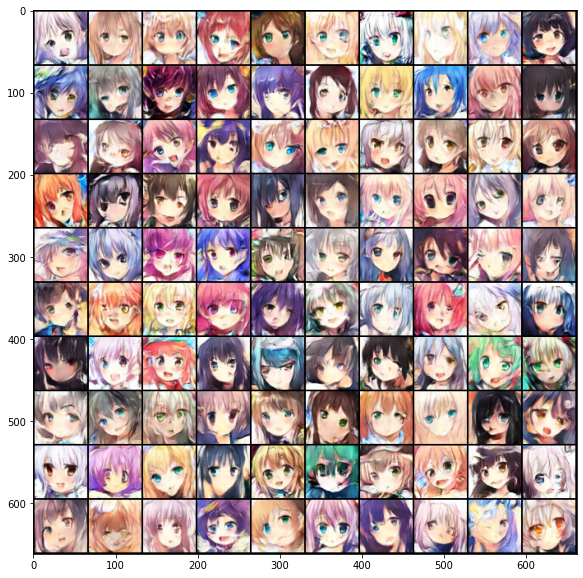

Epoch [32/50] 1115/1115 Loss_D: 0.0695 Loss_G: 1.1159 | Save some samples to ./logs\Epoch_032.jpg.


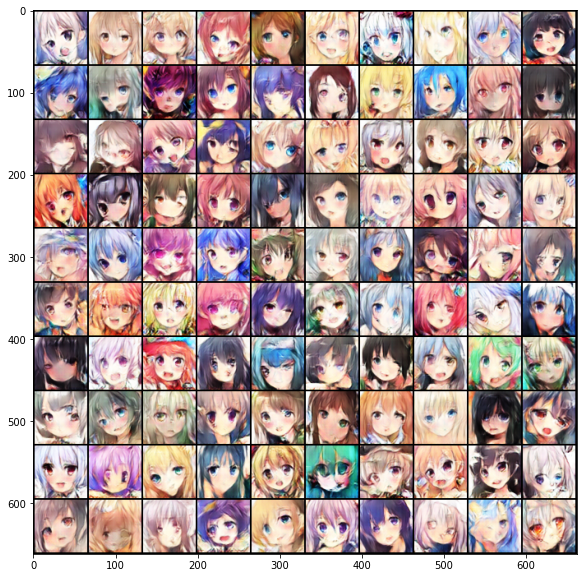

Epoch [33/50] 1115/1115 Loss_D: 0.0634 Loss_G: 0.2172 | Save some samples to ./logs\Epoch_033.jpg.


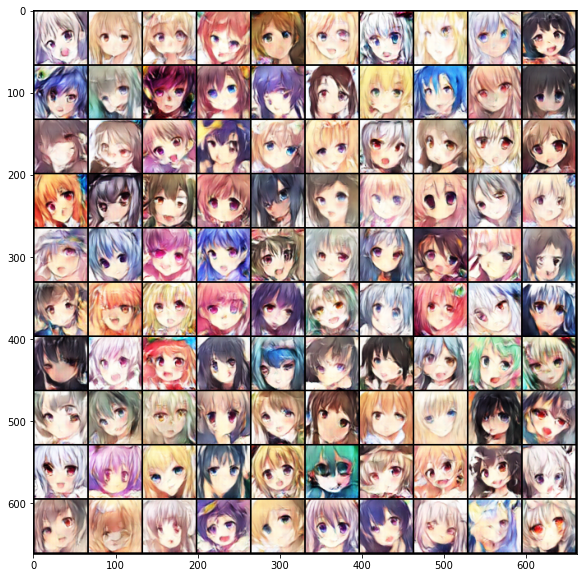

Epoch [34/50] 1115/1115 Loss_D: 0.0580 Loss_G: 0.7792 | Save some samples to ./logs\Epoch_034.jpg.


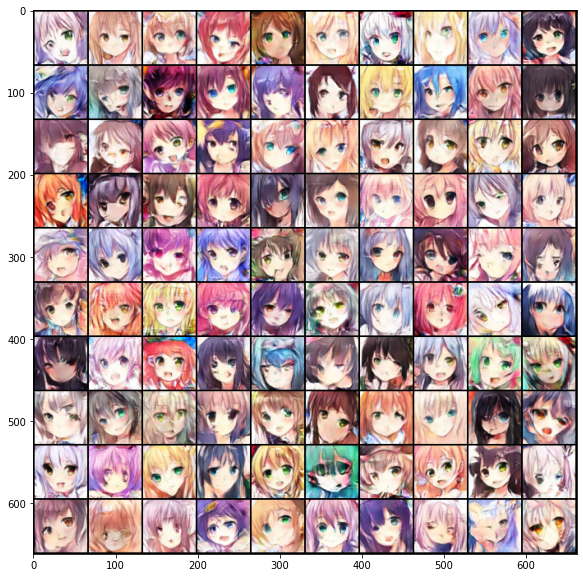

Epoch [35/50] 1115/1115 Loss_D: 0.0836 Loss_G: 0.5299 | Save some samples to ./logs\Epoch_035.jpg.


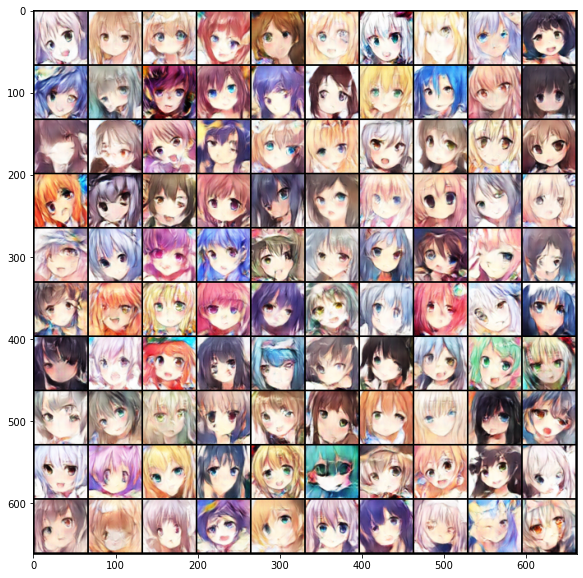

Epoch [36/50] 1115/1115 Loss_D: 0.0983 Loss_G: 0.4656 | Save some samples to ./logs\Epoch_036.jpg.


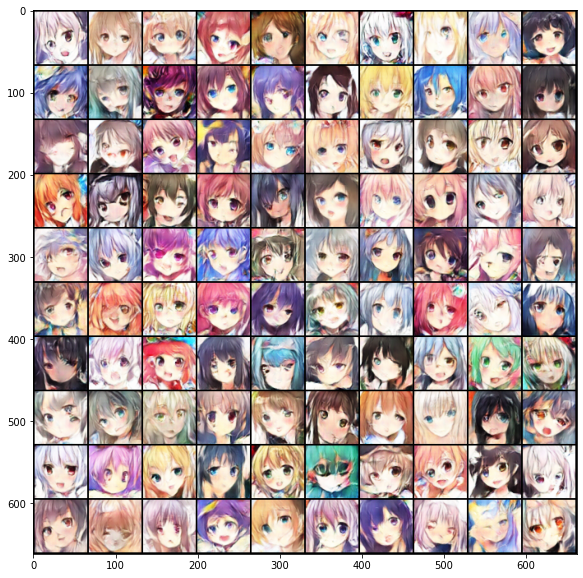

Epoch [37/50] 1115/1115 Loss_D: 0.0307 Loss_G: 0.3838 | Save some samples to ./logs\Epoch_037.jpg.


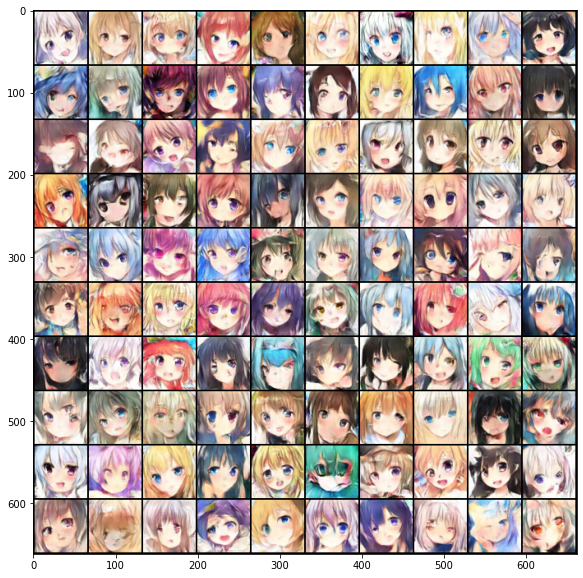

Epoch [38/50] 1115/1115 Loss_D: 0.0563 Loss_G: 1.1860 | Save some samples to ./logs\Epoch_038.jpg.


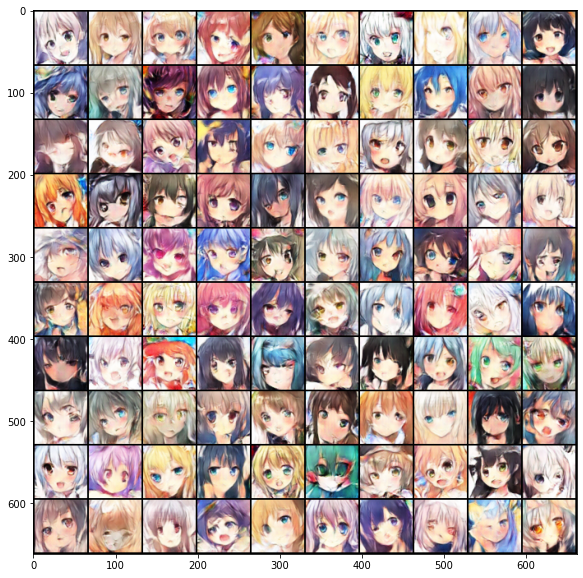

Epoch [39/50] 1115/1115 Loss_D: 0.0709 Loss_G: 0.5619 | Save some samples to ./logs\Epoch_039.jpg.


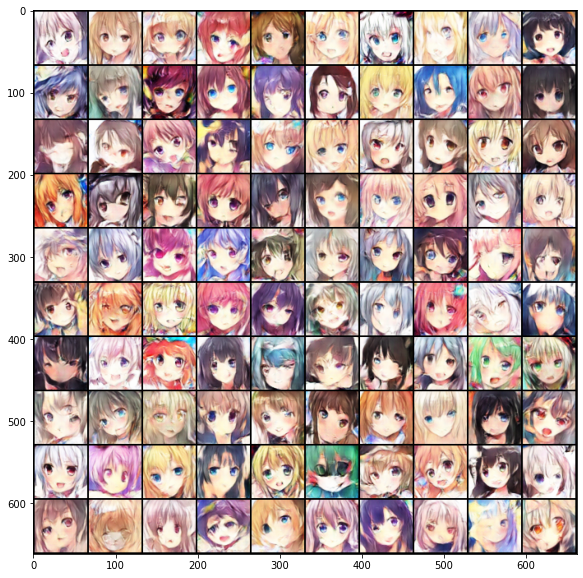

Epoch [40/50] 1115/1115 Loss_D: 0.1109 Loss_G: 1.0817 | Save some samples to ./logs\Epoch_040.jpg.


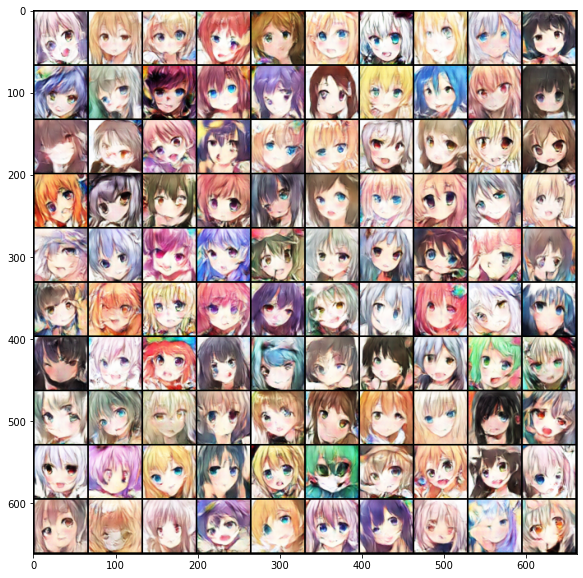

Epoch [41/50] 1115/1115 Loss_D: 0.2243 Loss_G: 0.4892 | Save some samples to ./logs\Epoch_041.jpg.


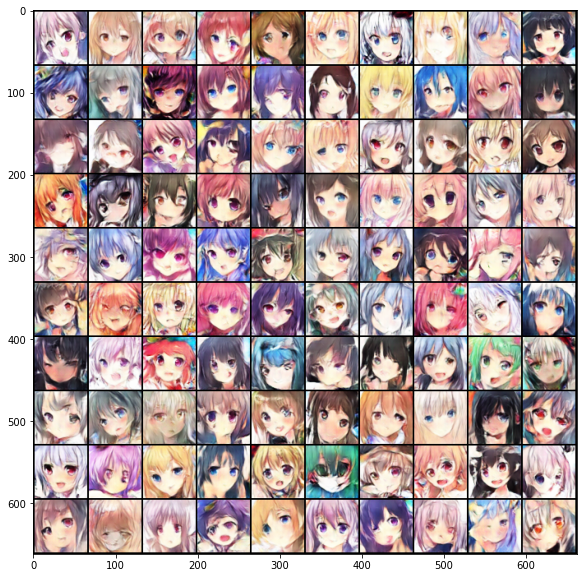

Epoch [42/50] 1115/1115 Loss_D: 0.1312 Loss_G: 1.6718 | Save some samples to ./logs\Epoch_042.jpg.


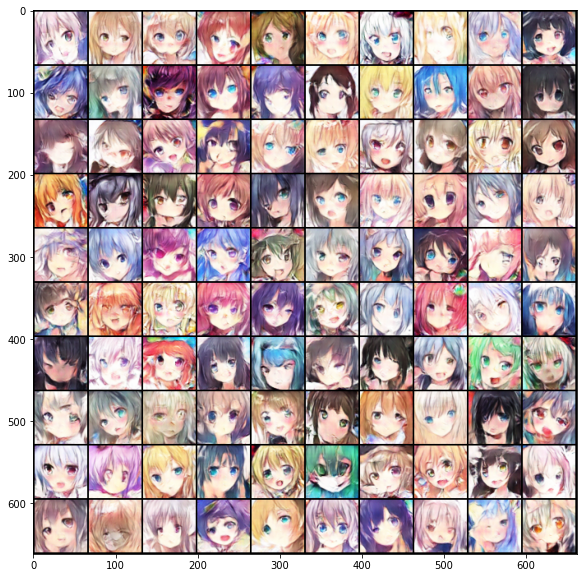

Epoch [43/50] 1115/1115 Loss_D: 0.0946 Loss_G: 0.1200 | Save some samples to ./logs\Epoch_043.jpg.


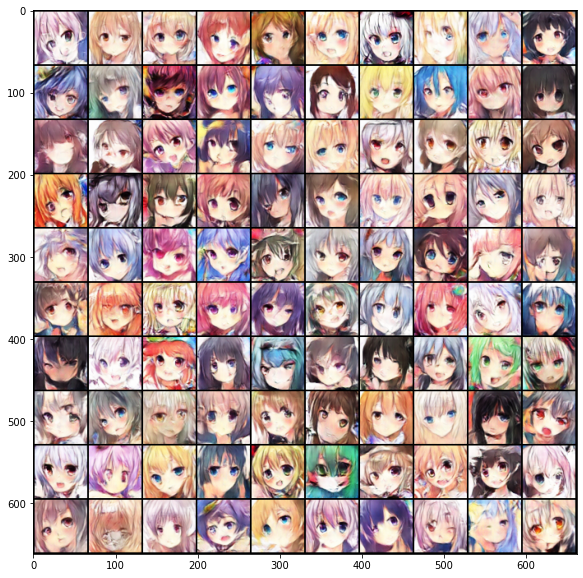

Epoch [44/50] 1115/1115 Loss_D: 0.0243 Loss_G: 1.3942 | Save some samples to ./logs\Epoch_044.jpg.


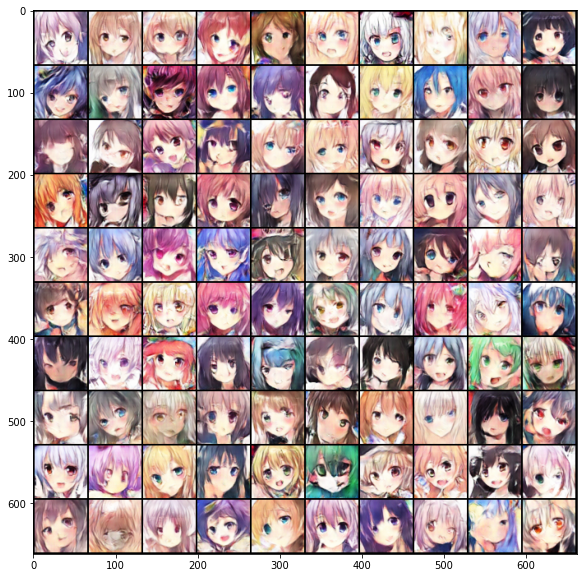

Epoch [45/50] 1115/1115 Loss_D: 0.0514 Loss_G: 1.3705 | Save some samples to ./logs\Epoch_045.jpg.


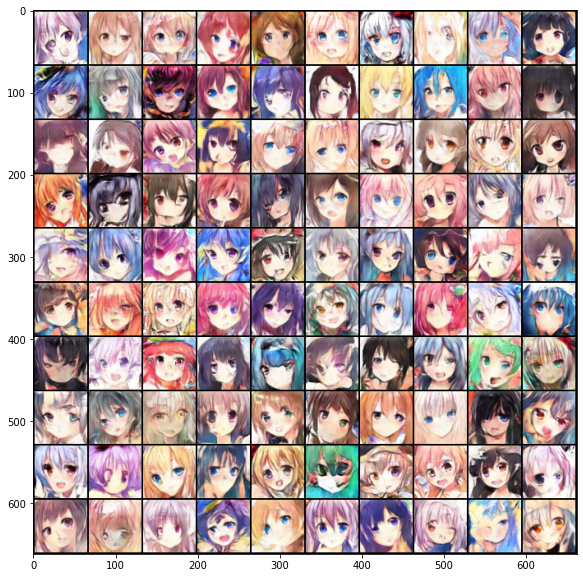

Epoch [46/50] 1115/1115 Loss_D: 0.0914 Loss_G: 1.1303 | Save some samples to ./logs\Epoch_046.jpg.


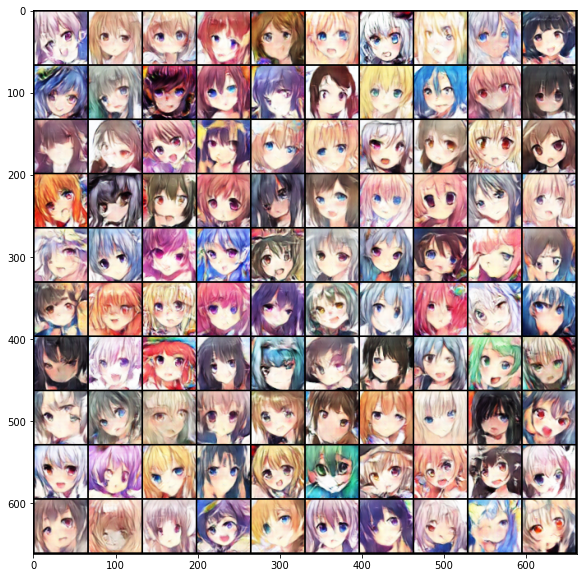

Epoch [47/50] 1115/1115 Loss_D: 0.2325 Loss_G: 0.4437 | Save some samples to ./logs\Epoch_047.jpg.


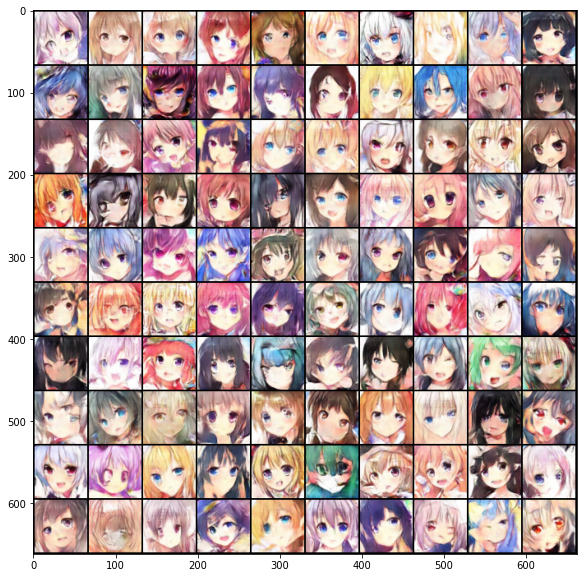

Epoch [48/50] 1115/1115 Loss_D: 0.2063 Loss_G: 0.4993 | Save some samples to ./logs\Epoch_048.jpg.


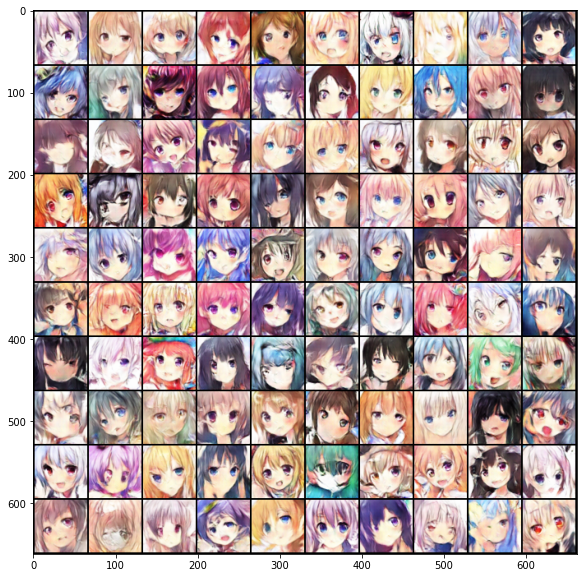

Epoch [49/50] 1115/1115 Loss_D: 0.1962 Loss_G: 1.6627 | Save some samples to ./logs\Epoch_049.jpg.


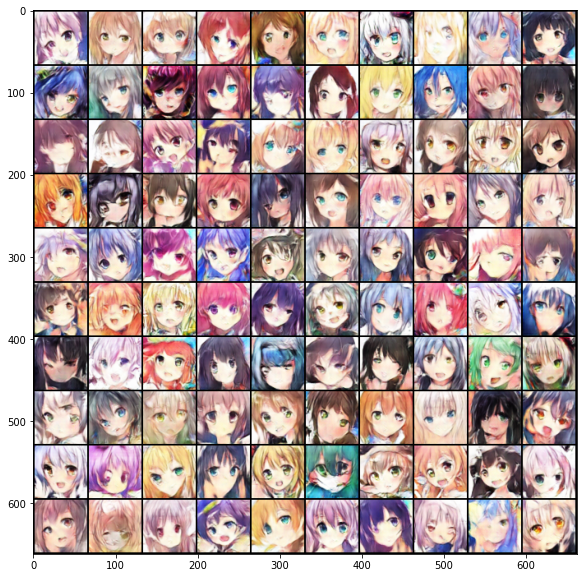

Epoch [50/50] 1115/1115 Loss_D: 0.1010 Loss_G: 0.4822 | Save some samples to ./logs\Epoch_050.jpg.


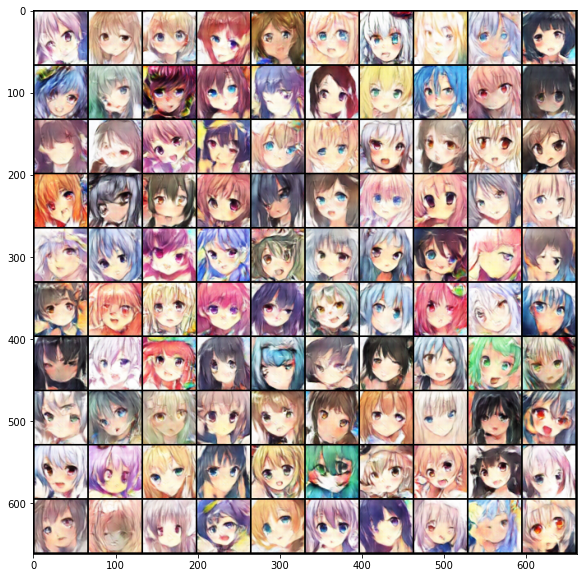

In [6]:
# for logging
z_sample = Variable(torch.randn(100, z_dim)).cuda()

for e, epoch in enumerate(range(n_epoch)):
    for i, data in enumerate(dataloader):
        imgs = data
        imgs = imgs.cuda()

        bs = imgs.size(0)

        """ Train D """
        z = Variable(torch.randn(bs, z_dim)).cuda()
        r_imgs = Variable(imgs).cuda()
        f_imgs = G(z)

        # label        
        r_label = torch.ones((bs,1)).cuda()
        f_label = torch.zeros((bs,1)).cuda()

        # dis
        r_logit = D(r_imgs.detach())
        f_logit = D(f_imgs.detach())

        # compute loss
        r_loss = criterion(r_logit, r_label)
        f_loss = criterion(f_logit, f_label)
        
        loss_D = (r_loss + f_loss) / 2

        # update model
        D.zero_grad()
        loss_D.backward()
        opt_D.step()

        """ train G """
        # leaf
        z = Variable(torch.randn(bs, z_dim)).cuda()
        f_imgs = G(z)

        # dis
        f_logit = D(f_imgs)
        
        # compute loss
        loss_G = criterion(f_logit, r_label)

        # update model
        G.zero_grad()
        loss_G.backward()
        opt_G.step()

        # log
        print(f'\rEpoch [{epoch+1}/{n_epoch}] {i+1}/{len(dataloader)} Loss_D: {loss_D.item():.4f} Loss_G: {loss_G.item():.4f}', end='')
    G.eval()
    f_imgs_sample = (G(z_sample).data + 1) / 2.0
    filename = os.path.join(save_dir, f'Epoch_{epoch+1:03d}.jpg')
    torchvision.utils.save_image(f_imgs_sample, filename, nrow=10)
    print(f' | Save some samples to {filename}.')
    # show generated image
    grid_img = torchvision.utils.make_grid(f_imgs_sample.cpu(), nrow=10)
    plt.figure(figsize=(10,10))
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.show()
    G.train()
    if (e+1) % 5 == 0:
        torch.save(G.state_dict(), f'lsgan_g.pth')
        torch.save(D.state_dict(), f'lsgan_d.pth')



# Inference
利用我們訓練好的 Generator 來隨機生成圖片。

In [7]:
import torch
# load pretrained model
G = Generator(z_dim)
G.load_state_dict(torch.load(os.path.join('./', 'lsgan_g.pth')))
G.eval()
G.cuda()

Generator(
  (l1): Sequential(
    (0): Linear(in_features=100, out_features=8192, bias=False)
    (1): BatchNorm1d(8192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (l2_5): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (1): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (2): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()


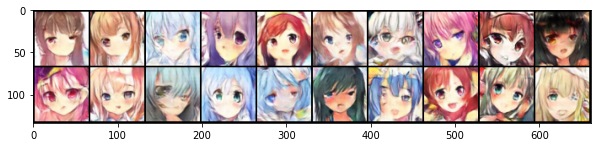

In [25]:
# generate images and save the result
n_output = 20
z_sample = Variable(torch.randn(n_output, z_dim)).cuda()
imgs_sample = (G(z_sample).data + 1) / 2.0
save_dir = os.path.join('./', 'logs')
filename = os.path.join(save_dir, f'result_{n_epoch}Epochs.jpg')
torchvision.utils.save_image(imgs_sample, filename, nrow=10)
# show image
grid_img = torchvision.utils.make_grid(imgs_sample.cpu(), nrow=10)
plt.figure(figsize=(10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

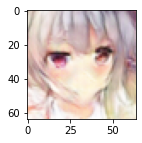

In [21]:
# generate images and save the result
n_output = 1
z_sample = Variable(torch.randn(n_output, z_dim)).cuda()
imgs_sample = (G(z_sample).data + 1) / 2.0
save_dir = os.path.join('./', 'logs')
filename = os.path.join(save_dir, f'result_{n_epoch}Epochs_1.jpg')
torchvision.utils.save_image(imgs_sample, filename, nrow=10)
# show image
grid_img = torchvision.utils.make_grid(imgs_sample.cpu(), nrow=10)
plt.figure(figsize=(2,2))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

In [17]:
import glob
from PIL import Image

# filepaths
fp_in = "./logs/LSGAN/50/Epoch_*.jpg"
fp_out = "./logs/LSGAN/50/LSGAN_image.gif"

# https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
img.save(fp=fp_out, format='GIF', append_images=imgs,
         save_all=True, duration=200, loop=0)

In [8]:
import imageio
import glob
from PIL import Image
fp_in = "./logs/LSGAN/50/Epoch_*.jpg"
fp_out = "./logs/LSGAN/50/LSGAN_image.gif"
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
imageio.mimsave("test.gif",imgs,fps=10)

In [10]:
imageio.mimsave("test.gif",imgs,fps=7)